In [3]:
BASE_FOLDER = '../../../'
import numpy as np
import os
import math
import matplotlib.pyplot as plt
import librosa
import librosa.display
import scipy.signal as sig
from pydub import AudioSegment
%run -i ..\..\..\utility\feature_extractor\JupyterLoad_feature_extractor.py

load feature_extractor_mother
load feature_extractor_mel_spectra
load feature_extractor_psd
load feature_extractor_ICA2
load feature_extractore_pre_nnFilterDenoise
load extractor_diagram_mother
load Simple_FIR_HP
load TimeSliceAppendActivation


In [4]:
def load_audio(filepath):
    return librosa.load(os.path.abspath(BASE_FOLDER+filepath), sr=None, mono=False)

In [62]:
def mel_plot(f,nr,title,ini=False):
    plt.subplot(2,4,nr)
    mel_n2 = feature_extractor_mel(BASE_FOLDER,'mel1')
    mel_n2.set_hyperparamter(n_mels=240, n_fft=2048)
    mel_n2.create_from_wav(f)
    mel_n2.plot(colorbar=False)
    plt.xlabel('time frames [sec]')
    plt.ylabel('')
    plt.title(f'MEL spectrum ' + title)
    if ini:
        plt.xlabel('time frames [sec]')
        plt.ylabel('MEL freq [Hz]')
    else:
        ax = plt.gca()
        plt.setp( ax.get_yticklabels(), visible=False)
        
def psd_plot(f,nr,title,ini=False,axm1=None):
    plt.subplot(2,4,nr,sharey=axm1)
    psd_n2 = feature_extractor_welchPSD(BASE_FOLDER,'psd')
    psd_n2.set_hyperparamter(nfft=1024, nperseg=512)
    psd_n2.create_from_wav(f)
    psd_n2.plot(loglog=True)
    plt.xlabel('time frames [sec]')
    plt.ylabel('')
    plt.title(f'Welch spec. ' + title)
    plt.grid()
    if ini:
        plt.xlabel('freq. [Hz]')
        plt.ylabel('power [V^2]')

    else:
        ax = plt.gca()
        plt.setp( ax.get_yticklabels(), visible=False)
    return plt.gca()

def move_wav_mp3(fin,fout):
    AudioSegment.from_wav(fin).normalize().export(fout, format="mp3")

def filenamepatchMP3(f,i):
    return f.replace('\\','_').replace('.wav',f'plt{i}.mp3')
def move_all_wav(fn1,fn2,fa1,fa2,title):
    for i,f in enumerate([fn1,fn2,fa1,fa2]):
        move_wav_mp3(os.path.abspath(BASE_FOLDER+f),
                 '.\\'+title.replace(' ','_')+'\\'+
                     filenamepatchMP3(f,i))
    

    
def html_section(fn1,fn2,fa1,fa2,title):
    main_fname = title.replace(' ','_')
    with open('./' + main_fname + '/' + main_fname + '.html', 'w') as file:  
        file.write(f'<img src="{main_fname}/{main_fname}.png" alt="sectra" style="width:1120px;height:630px;">\n')
        file.write('<table style="width:1120px;">\n')
        file.write('  <tr>\n')
        for i,f in enumerate([fn1,fn2,fa1,fa2]):
            file.write(f'    <th><audio src="{main_fname}/{filenamepatchMP3(f,i)}" controls preload></audio></th>\n')
        file.write('  </tr>\n')
        file.write('</table>\n')
    pass

def plot_it(fn1,fn2,fa1,fa2,title, mp3=False):
    fig = plt.figure(figsize=(16,9))
    mel_plot(fn1,1, 'normal ', True)
    if fn2:
        mel_plot(fn2,2, 'false alarm', False)
    else:
        mel_plot(fn1,1, 'normal ', True)
        
    mel_plot(fa1,3, 'abnormal ', False)
    mel_plot(fa2,4, 'abnormal missed', False)

    ax = psd_plot(fn1,5,'normal ',True)
    if fn2:
        ax = psd_plot(fn2,6,'false alarm',False, ax)
    else:
        ax = psd_plot(fn1,5,'normal ',True)
    ax = psd_plot(fa1,7,'abnormal ',False, ax)
    ax = psd_plot(fa2,8,'abnormal missed',False, ax)
    
   
    
   
    plt.tight_layout()
    
    fig.suptitle(title,fontsize=18,y=1.0001)
    plt.subplots_adjust(top=0.94)
    
    os.makedirs(title.replace(' ','_'), exist_ok=True)
    plt.savefig('.\\' + title.replace(' ','_')+ '\\' + title.replace(' ','_') + '.png', transparent=False, dpi=300)
    if mp3:
        if fn2==None:
            fn2 = fn1
        move_all_wav(fn1,fn2,fa1,fa2,title)
        html_section(fn1,fn2,fa1,fa2,title)
    
    
    
 


In [11]:
# import ensambele 
import pickle

dd = pickle.load( open( BASE_FOLDER + '\modeling\ensemble\ensemble_dfs.dataframe' , "rb" ))

#for d in dd:
#    print(d)
exp1 = 'min6dB_pump_00' 


dd[exp1].columns

Index(['AutoEnc_MEL_den_pred_scores', 'IsoFor_MEL_den_pred_scores',
       'IsoFor_PSD_raw_pred_scores', 'score_agg_weighted',
       'score_agg_unweighted', 'prediction_abnormal_weighted', 'ground_truth'],
      dtype='object')

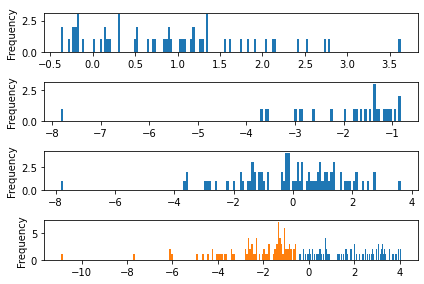

In [34]:

# ge
df = dd[exp1]
df = df.eval('miss = prediction_abnormal_weighted != ground_truth')
df = df.eval('miss_ab = miss & (-1== ground_truth)')
df = df.eval('miss_no = miss & (1== ground_truth)')
df.head()
plt.subplot(411)
df[df.miss_ab==True]['score_agg_unweighted'].plot.hist(bins=150)
plt.subplot(412)
df[df.miss_no==True]['score_agg_unweighted'].plot.hist(bins=150)
plt.subplot(413)
df[df.miss==True]['score_agg_unweighted'].plot.hist(bins=150)
plt.subplot(414)
df[(df.miss==False) & (df.ground_truth==1)]['score_agg_unweighted'].plot.hist(bins=150)
df[(df.miss==False) & (df.ground_truth==-1)]['score_agg_unweighted'].plot.hist(bins=150)
plt.tight_layout()

In [63]:
# mean and std of miss_ab
def get_examples(df):
    df = df.eval('miss = prediction_abnormal_weighted != ground_truth')
    df = df.eval('miss_ab = miss & (-1== ground_truth)')
    df = df.eval('miss_no = miss & (1== ground_truth)')

    
    s = df[df.miss_ab==True]['score_agg_weighted'].std()
    m = df[df.miss_ab==True]['score_agg_weighted'].mean()
    abnorm_difficult = df[df.miss_ab==True][df[df.miss_ab==True]['score_agg_weighted'] > m+s].iloc[0]
   
        
    s = df[df.miss_no==True]['score_agg_weighted'].std()
    m = df[df.miss_no==True]['score_agg_weighted'].mean()
    try:
        norm_difficult = df[df.miss_no==True][df[df.miss_no==True]['score_agg_weighted'] < m-s].iloc[0]
    except:
        norm_difficult = None
    m = df[(df.miss==False) & (df.ground_truth==1)]['score_agg_weighted'].mean()
    norm_easy = df[(df.miss==False) & (df.ground_truth==1)][df[(df.miss==False) & (df.ground_truth==1)]['score_agg_unweighted'] >= m].iloc[0]

    m = df[(df.miss==False) & (df.ground_truth==-1)]['score_agg_weighted'].mean()
    abnorm_easy = df[(df.miss==False) & (df.ground_truth==-1)][df[(df.miss==False) & (df.ground_truth==-1)]['score_agg_unweighted'] < m].iloc[0]
    
    return abnorm_difficult, norm_difficult, norm_easy, abnorm_easy

In [71]:
type(norm_difficult) is pd.core.series.Series

False

..\..\..\utility\feature_extractor\JupyterLoad_feature_extractor.py:2: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # this file loads all components
..\..\..\utility\feature_extractor\JupyterLoad_feature_extractor.py:18: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  
..\..\..\utility\feature_extractor\JupyterLoad_feature_extractor.py:2: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes cur

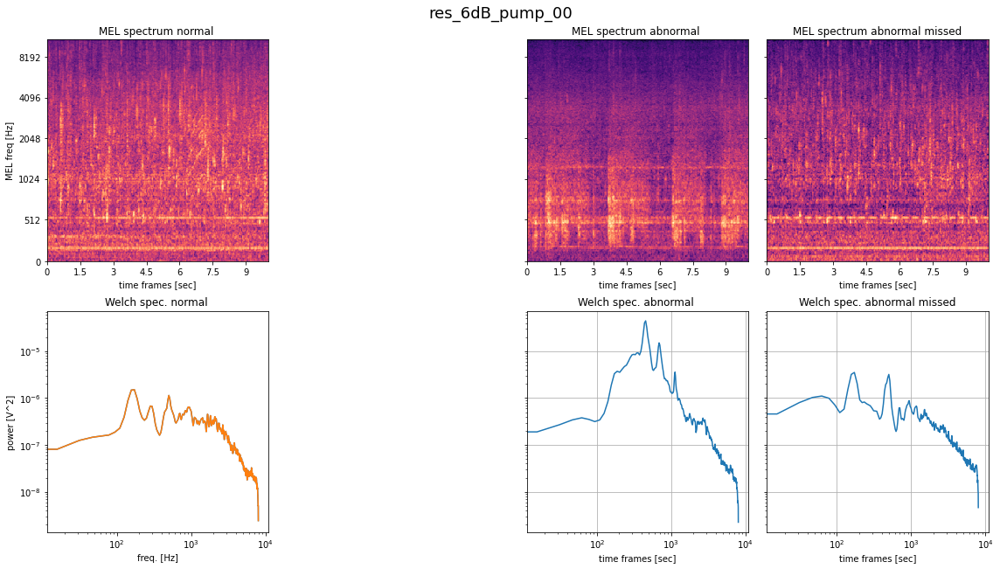

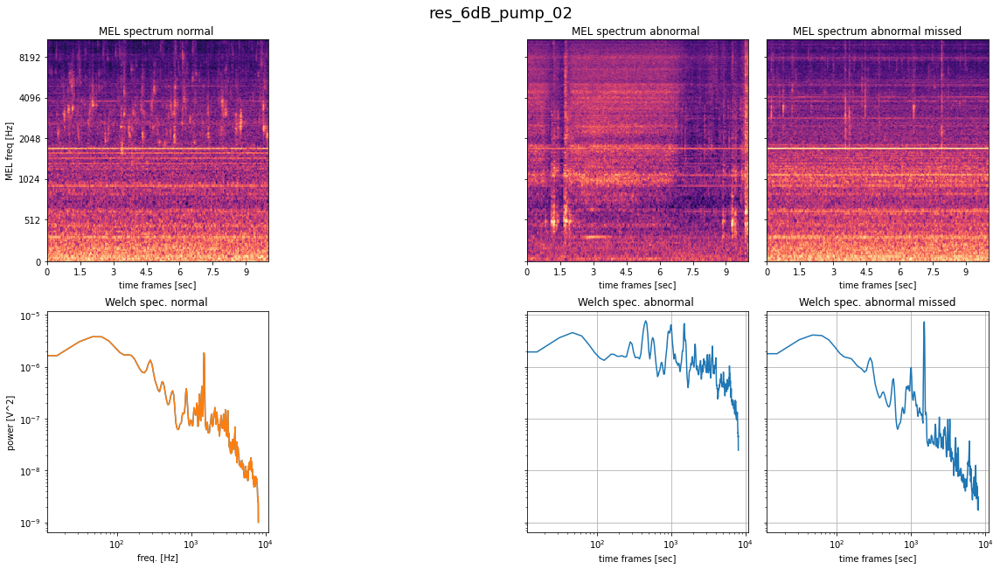

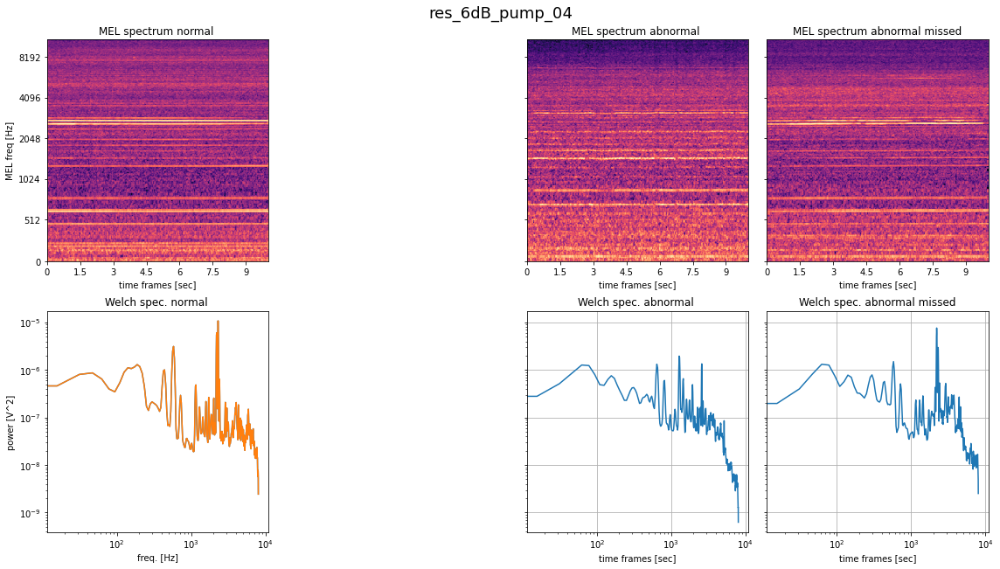

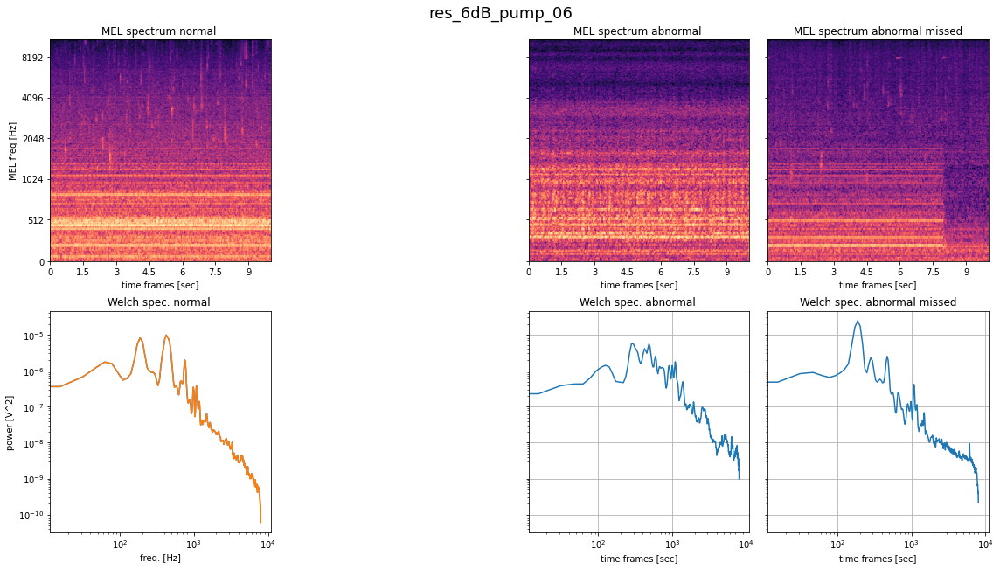

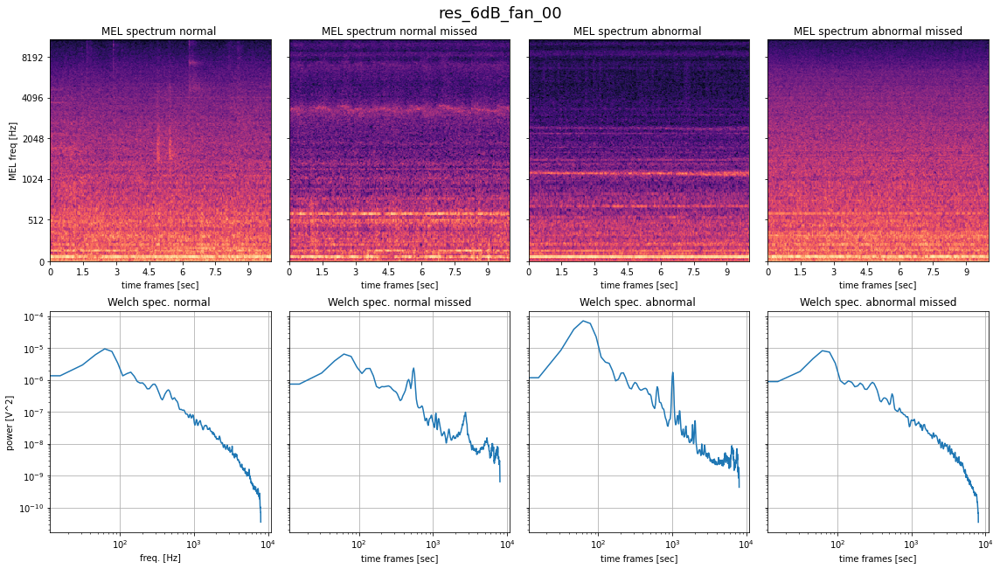

...

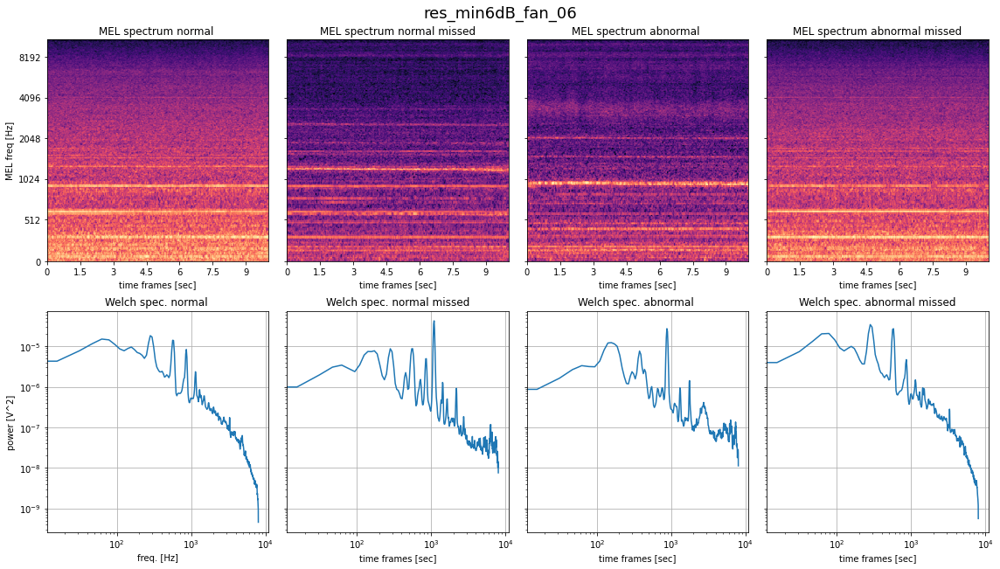

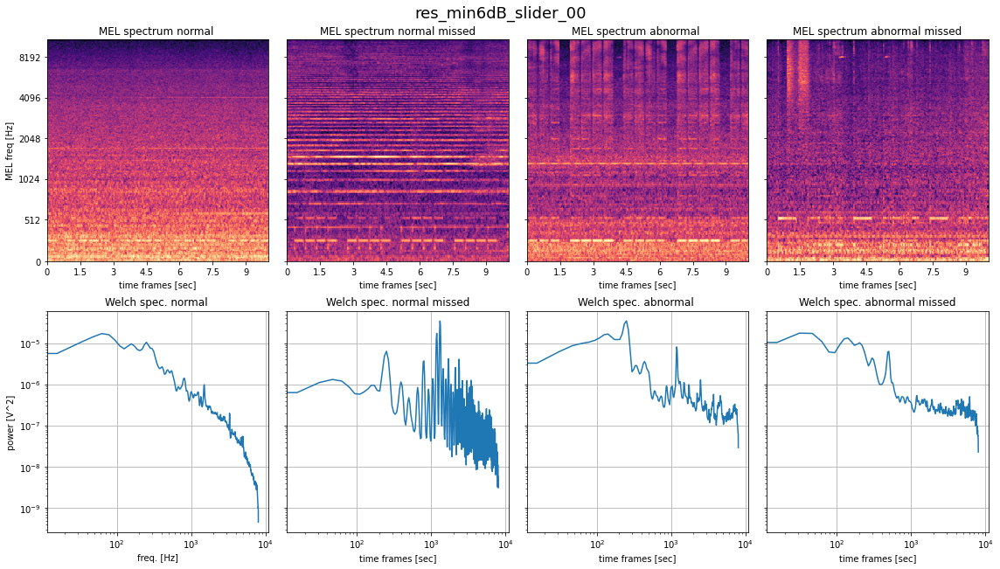

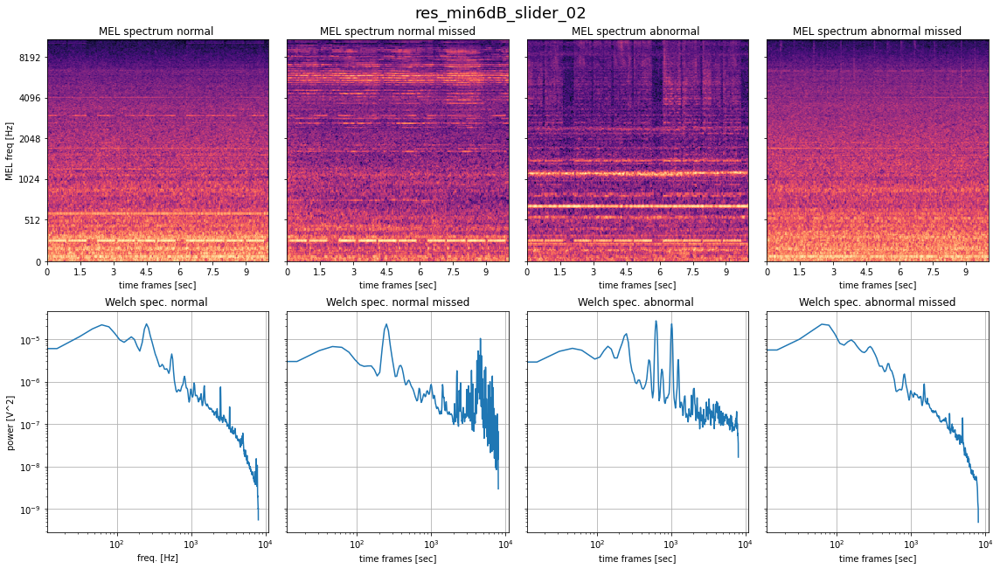

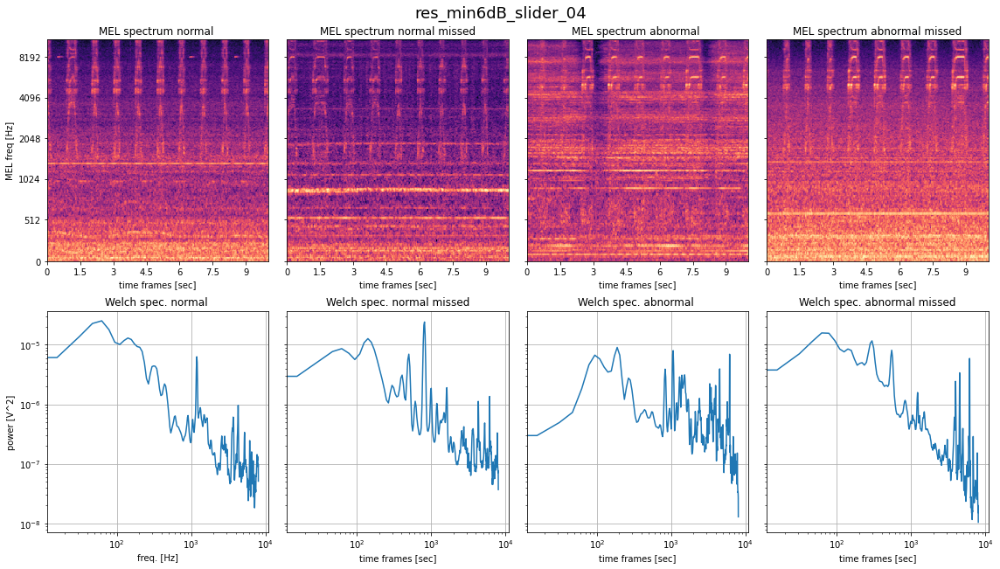

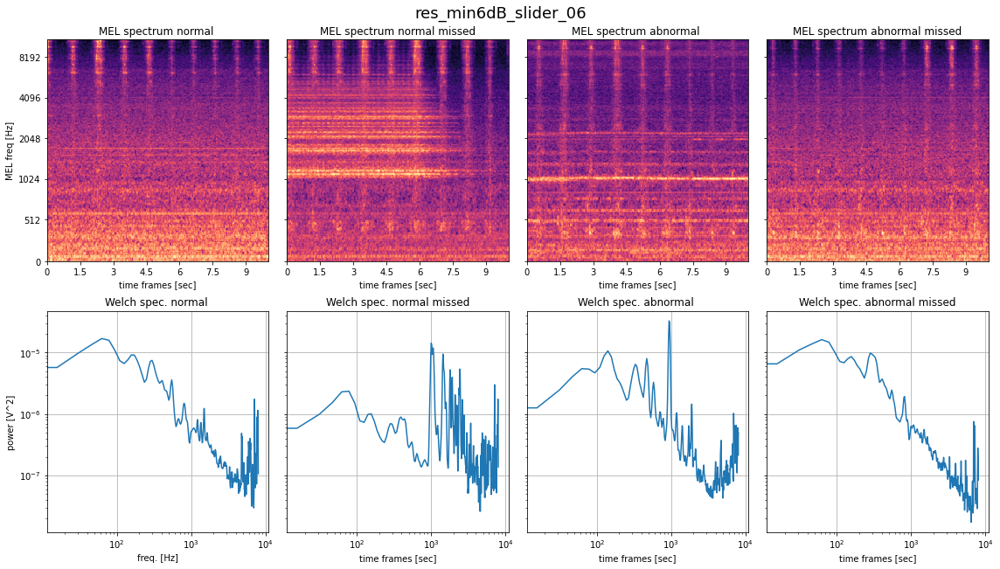

In [72]:
import pickle
dd = pickle.load( open( BASE_FOLDER + '\modeling\ensemble\ensemble_dfs.dataframe' , "rb" ))

for d in dd:
    abnorm_difficult, norm_difficult, norm_easy, abnorm_easy =  get_examples(dd[ d ])

    fn1 = norm_easy.name
    fa1 = abnorm_easy.name
    if type(norm_difficult) is pd.core.series.Series:
        fn2 = norm_difficult.name
    else:
        fn2 = None
    fa2 = abnorm_difficult.name
    plot_it(fn1,fn2,fa1,fa2,'res_'+d, mp3=True)

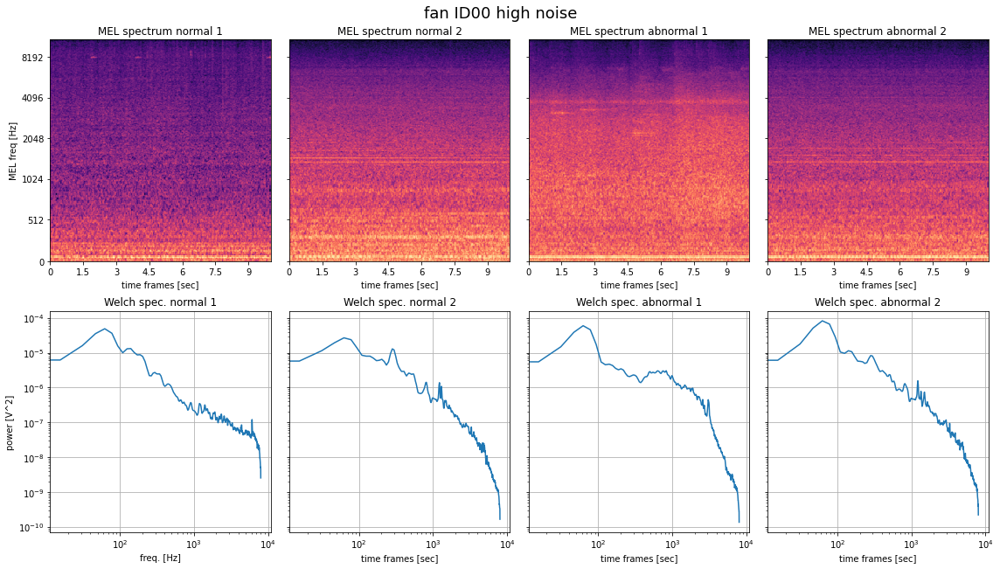

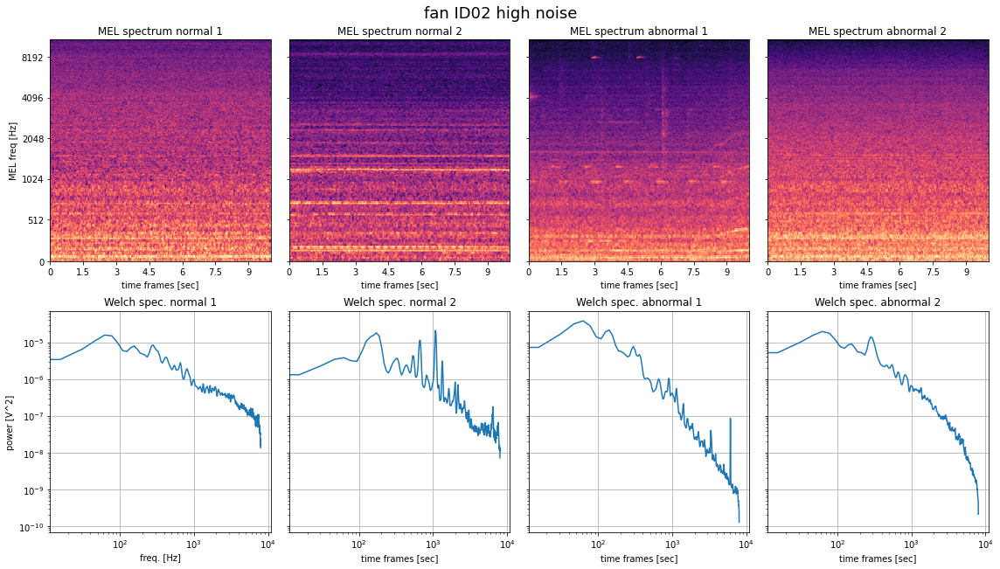

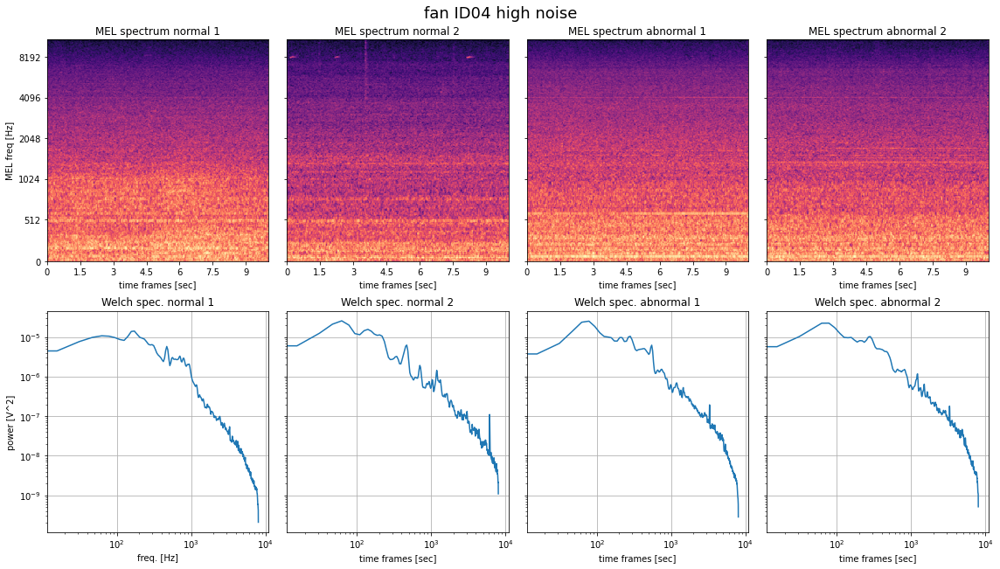

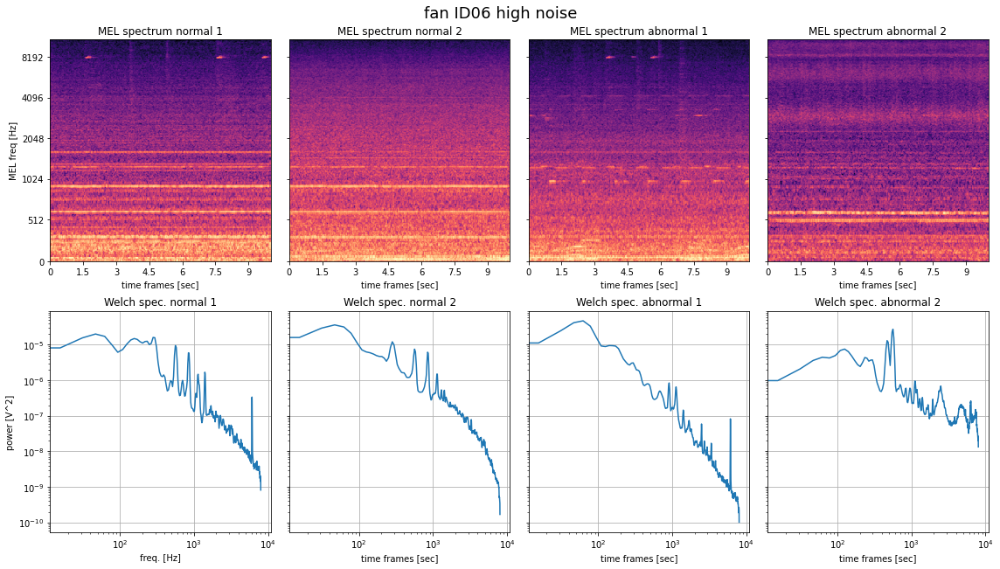

In [21]:
for idx in ['00','02','04','06']:
    fn1 = r'dataset\min6dB\fan\id_' +idx+ r'\normal\00000108.wav'
    fa1 = r'dataset\min6dB\fan\id_' +idx+r'\abnormal\00000080.wav'
    fn2 = r'dataset\min6dB\fan\id_' +idx+r'\normal\00000355.wav'
    fa2 = r'dataset\min6dB\fan\id_' +idx+ r'\abnormal\00000105.wav'
    plot_it(fn1,fn2,fa1,fa2,'fan ID' +idx+ ' high noise', mp3=True)